### HomeWork 09
### EXPERIMENT 01- DEEP DREAM 

In [1]:
import tensorflow as tf
import numpy as np
import matplotlib as plt
import IPython.display as display
import PIL.Image
from tensorflow.keras.preprocessing import image

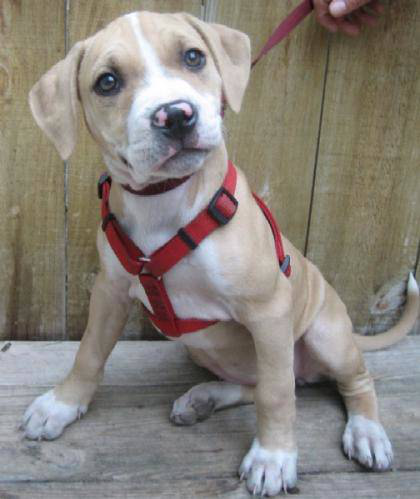

In [5]:
# Image to numpy array
def openImage(max_dim=None):
  img = PIL.Image.open('/home/labina/Lectures/AdvanceDeepLearning/datasets/cats_and_dogs_small/test/dogs/dog.1503.jpg')
  if max_dim:
    img.thumbnail((max_dim, max_dim))
  return np.array(img)

# normalize image
def deprocess(img):
  img = 255*(img + 1.0)/2.0
  return tf.cast(img, tf.uint8)

# display original image
def show(img):
  display.display(PIL.Image.fromarray(np.array(img)))

original_img = openImage(max_dim=500)
show(original_img)

#### Using Imagenet as Base model and  using 'mixed2', 'mixed3', 'mixed4','mixed5' as contibution layers

In [8]:
base_model = tf.keras.applications.InceptionV3(include_top =False, weights = 'imagenet')
#setting up the DeepDream Configuration,
#Dictionary mapping layer names to a sofficient quantifying how much the layer's activation contributes to the loaa you'll seek to maximize
layer_contibutions =['mixed2', 'mixed3', 'mixed4', 'mixed5']
layers = [base_model.get_layer(name).output for name in layer_contibutions]
#this tensor holds the generated image
dream_model = tf.keras.Model(inputs= base_model.input, outputs = layers)
#to calculate loss
def calc_loss(img,model):
    img_batch = tf.expand_dims(img,axis = 0)
    layer_activations = model(img_batch)
    if len(layer_activations) == 1:
        layer_activation = [layer_activations]
        
    losses = []
    for act in layer_activations:
        loss = tf.math.reduce_mean(act)
        losses.append(loss)
        
    return tf.reduce_sum(losses)

#gradient descent 

class DeepDream(tf.Module):
  def __init__(self, model):
    self.model = model

  @tf.function(
      input_signature=(
        tf.TensorSpec(shape=[None,None,3], dtype=tf.float32),
        tf.TensorSpec(shape=[], dtype=tf.int32),
        tf.TensorSpec(shape=[], dtype=tf.float32),)
  )
  def __call__(self, img, steps, step_size):
      print("Tracing")
      loss = tf.constant(0.0)
      for n in tf.range(steps):
        with tf.GradientTape() as tape:
          tape.watch(img)
          loss = calc_loss(img, self.model)

        gradients = tape.gradient(loss, img)

        gradients /= tf.math.reduce_std(gradients) + 1e-8 
        
        img = img + gradients*step_size
        img = tf.clip_by_value(img, -1, 1)

      return loss, img



In [9]:
deepdream = DeepDream(dream_model)

### EXPERIMENT-01, Test-01: Without using Octave 

In [10]:
def run_deep_dream_simple(img, steps=100, step_size=0.01):
  # let's cpnvert from uint8 to the range expected by the model
  img = tf.keras.applications.inception_v3.preprocess_input(img)
  img = tf.convert_to_tensor(img)
  step_size = tf.convert_to_tensor(step_size)
  steps_remaining = steps
  step = 0
  while steps_remaining:
    if steps_remaining>100:
      run_steps = tf.constant(100)
    else:
      run_steps = tf.constant(steps_remaining)
    steps_remaining -= run_steps
    step += run_steps

    loss, img = deepdream(img, run_steps, tf.constant(step_size))

    display.clear_output(wait=True)
    show(deprocess(img))
    print ("Step {}, loss {}".format(step, loss))


  result = deprocess(img)
  display.clear_output(wait=True)
  show(result)

  return result

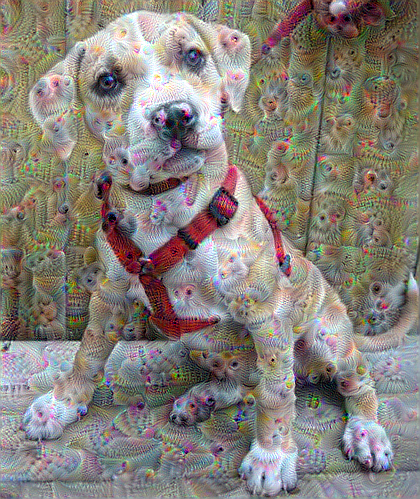

In [11]:
dream_img = run_deep_dream_simple(img=original_img, 
                                  steps=100, step_size=0.01)

#### We got our first result from deep dream, but we can see that the output is abit noisy, and the patterns appear like they're all happening at the same granularity.  One solution for this problem is applying gradient ascent at different scales, and then increase the size of the image which is also known as octave. 

### EXPERIMENT-01, Test-02: Using octave to remove noise

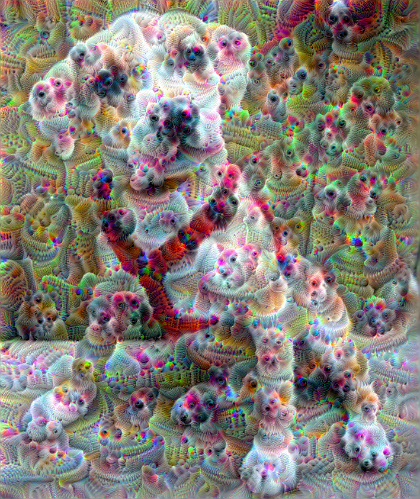

87.9427764415741

In [12]:
import time
start = time.time()

OCTAVE_SCALE = 1.30

img = tf.constant(np.array(original_img))
base_shape = tf.shape(img)[:-1]
float_base_shape = tf.cast(base_shape, tf.float32)

for n in range(-2, 3):
  new_shape = tf.cast(float_base_shape*(OCTAVE_SCALE**n), tf.int32)

  img = tf.image.resize(img, new_shape).numpy()

  img = run_deep_dream_simple(img=img, steps=50, step_size=0.01)

display.clear_output(wait=True)
img = tf.image.resize(img, base_shape)
img = tf.image.convert_image_dtype(img/255.0, dtype=tf.uint8)
show(img)

end = time.time()
end-start

### As we can see, the patterns are more visiable than the previous experiment

### EXPERIMENT-01, TEst-03, Scaling up with tiles, so that the ocatave implementation will also work on very large images, or many octaves

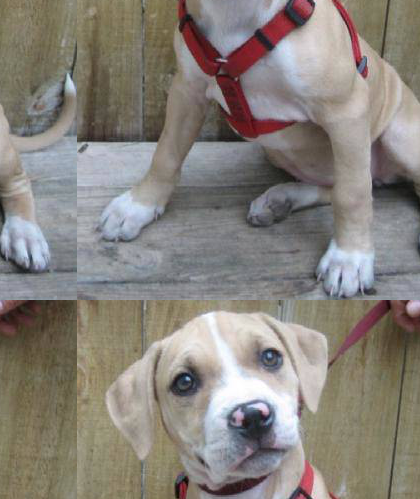

In [14]:
def random_roll(img, maxroll):
  # Randomly shift the image to avoid tiled boundari
  shift = tf.random.uniform(shape=[2], minval=-maxroll, maxval=maxroll, dtype=tf.int32)
  shift_down, shift_right = shift[0],shift[1] 
  img_rolled = tf.roll(tf.roll(img, shift_right, axis=1), shift_down, axis=0)
  return shift_down, shift_right, img_rolled

shift_down, shift_right, img_rolled = random_roll(np.array(original_img), 512)
show(img_rolled)

In [15]:
class TiledGradients(tf.Module):
  def __init__(self, model):
    self.model = model

  @tf.function(
      input_signature=(
        tf.TensorSpec(shape=[None,None,3], dtype=tf.float32),
        tf.TensorSpec(shape=[], dtype=tf.int32),)
  )
  def __call__(self, img, tile_size=512):
    shift_down, shift_right, img_rolled = random_roll(img, tile_size)

    #Initialize the image gradients to zero.  
    gradients = tf.zeros_like(img_rolled)

    # Skip the last tile, unless there's only one tile.
    xs = tf.range(0, img_rolled.shape[0], tile_size)[:-1]
    if not tf.cast(len(xs), bool):
      xs = tf.constant([0])
    ys = tf.range(0, img_rolled.shape[1], tile_size)[:-1]
    if not tf.cast(len(ys), bool):
      ys = tf.constant([0])

    for x in xs:
      for y in ys:
        # Calculate the gradients for this tile.
        with tf.GradientTape() as tape:
           # This needs gradients relative to `img_rolled`.
          # `GradientTape` only watches `tf.Variable`s by default.
          tape.watch(img_rolled)

          # Extract a tile out of the image.
          img_tile = img_rolled[x:x+tile_size, y:y+tile_size]
          loss = calc_loss(img_tile, self.model)

        # Update the image gradients for this tile.
        gradients = gradients + tape.gradient(loss, img_rolled)

    # Undo the random shift applied to the image and its gradients.
    gradients = tf.roll(tf.roll(gradients, -shift_right, axis=1), -shift_down, axis=0)

    # Normalize the gradients.
    gradients /= tf.math.reduce_std(gradients) + 1e-8 

    return gradients 

In [16]:
get_tiled_gradients = TiledGradients(dream_model)

In [17]:
def run_deep_dream_with_octaves(img, steps_per_octave=100, step_size=0.01, 
                                octaves=range(-2,3), octave_scale=1.3):
  base_shape = tf.shape(img)
  img = tf.keras.preprocessing.image.img_to_array(img)
  img = tf.keras.applications.inception_v3.preprocess_input(img)

  initial_shape = img.shape[:-1]
  img = tf.image.resize(img, initial_shape)
  for octave in octaves:
    # 옥타브에 따라 이미지의 크기를 조정합니다.
    new_size = tf.cast(tf.convert_to_tensor(base_shape[:-1]), tf.float32)*(octave_scale**octave)
    img = tf.image.resize(img, tf.cast(new_size, tf.int32))

    for step in range(steps_per_octave):
      gradients = get_tiled_gradients(img)
      img = img + gradients*step_size
      img = tf.clip_by_value(img, -1, 1)

      if step % 10 == 0:
        display.clear_output(wait=True)
        show(deprocess(img))
        print ("Octave {}, Step {}".format(octave, step))

  result = deprocess(img)
  return result

### Test 04
Result for octave_scale 1.3

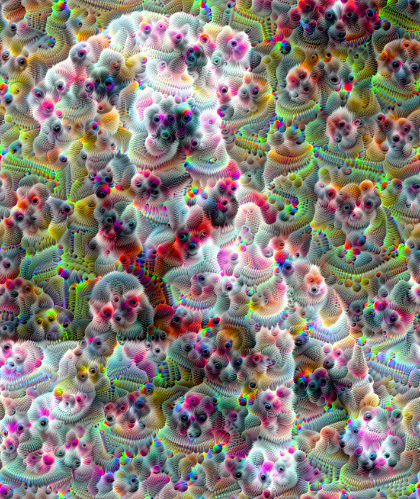

In [18]:
img1 = run_deep_dream_with_octaves(img=original_img, step_size=0.01)

display.clear_output(wait=True)
img1 = tf.image.resize(img1, base_shape)
img1 = tf.image.convert_image_dtype(img1/255.0, dtype=tf.uint8)
show(img1)

### Result for octave_scale 1.5

### Result for octave_scale 2.5

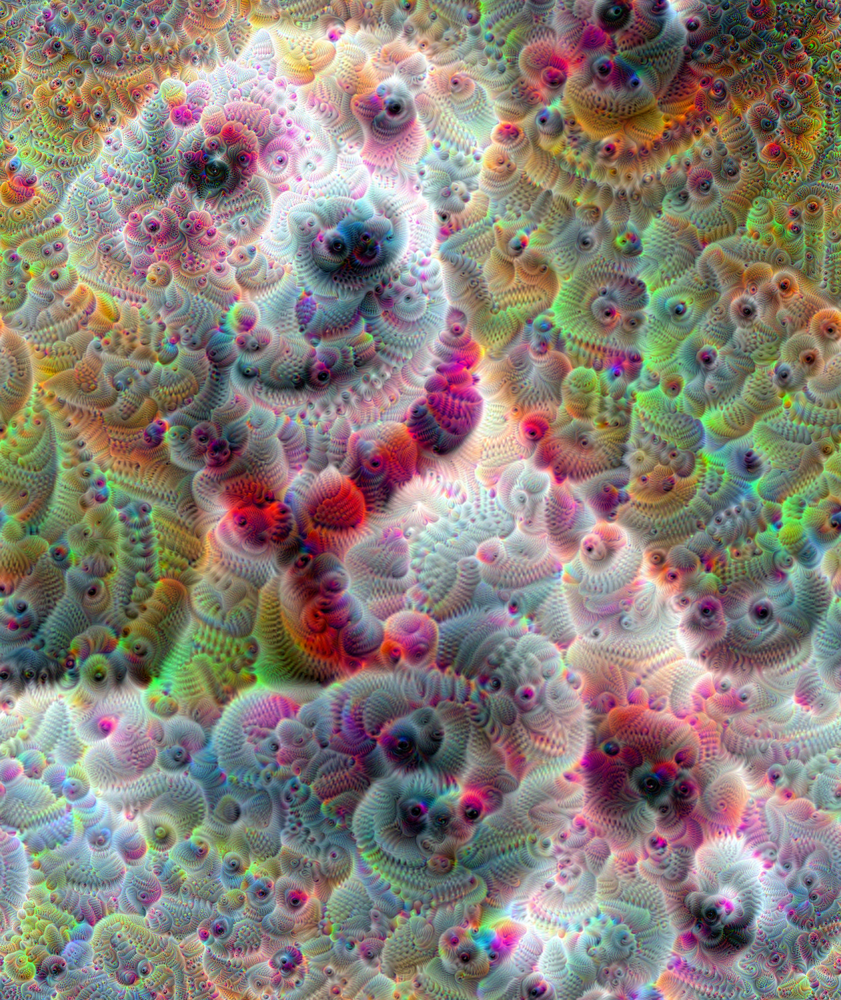

Octave 2, Step 90


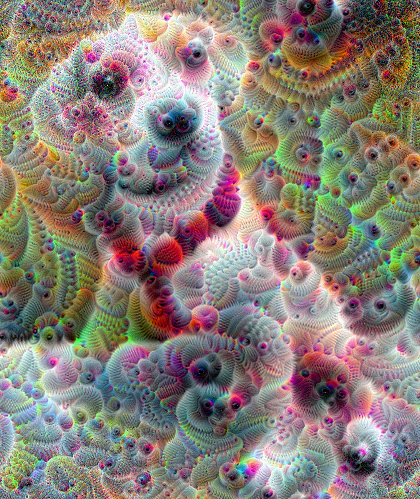

In [23]:
print("Changing the range of octaves to(-2,5) and scale to 2.5")
img3 = run_deep_dream_with_octaves(img=original_img,octaves = range(-2,3), octave_scale = 2.5, step_size=0.01)
img3 = tf.image.resize(img3, base_shape)
img3 = tf.image.convert_image_dtype(img3/255.0, dtype=tf.uint8)
show(img3)

### Result for octave_scale 0.5

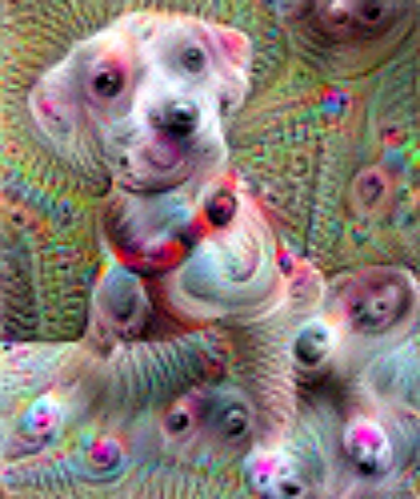

In [24]:
print("Changing the range of octaves to(-2,5) and scale to 0.5")
img4 = run_deep_dream_with_octaves(img=original_img,octaves = range(-2,3), octave_scale = 0.5, step_size=0.01)
display.clear_output(wait=True)
img4 = tf.image.resize(img4, base_shape)
img4 = tf.image.convert_image_dtype(img4/255.0, dtype=tf.uint8)
show(img4)

### Conclusion: 
#### The pattern differs according to octave scale, We can have very sharp patterns for greater octave scales.
--------------------------------------------------------------------------------------------------------------

## Experiment -2 
### Neural style Transfer 
This experiment uses deeplearning to compose one image in the style of another image
Neural style transfer is an optimization technique used to take two images ; a content image and a style reference image and blend them together so the input image looks like the content image, but "painted" in the style of the style reference image

In [2]:
import os
import tensorflow as tf
# Load compressed models from tensorflow_hub
os.environ['TFHUB_MODEL_LOAD_FORMAT'] = 'COMPRESSED'
import IPython.display as display

import matplotlib.pyplot as plt
import matplotlib as mpl
mpl.rcParams['figure.figsize'] = (12,12)
mpl.rcParams['axes.grid'] = False

import numpy as np
import PIL.Image
import time
import functools

In [3]:
def tensor_to_image(tensor):
  tensor = tensor*255
  tensor = np.array(tensor, dtype=np.uint8)
  if np.ndim(tensor)>3:
    assert tensor.shape[0] == 1
    tensor = tensor[0]
  return PIL.Image.fromarray(tensor)

In [50]:
content_path = tf.keras.utils.get_file('','/home/labina/Lectures/AdvanceDeepLearning/datasets/cats_and_dogs_small/test/dogs/dog.1503.jpg')
style_path = tf.keras.utils.get_file('kandinsky5.jpg','https://storage.googleapis.com/download.tensorflow.org/example_images/Vassily_Kandinsky%2C_1913_-_Composition_7.jpg')

### Visualizing the input


In [5]:
#define a function to load an image and limit its maximum dimensions to 512 pixels
def load_img(path_to_img):
  max_dim = 512
  img = tf.io.read_file(path_to_img)
  img = tf.image.decode_image(img, channels=3)
  img = tf.image.convert_image_dtype(img, tf.float32)

  shape = tf.cast(tf.shape(img)[:-1], tf.float32)
  long_dim = max(shape)
  scale = max_dim / long_dim

  new_shape = tf.cast(shape * scale, tf.int32)

  img = tf.image.resize(img, new_shape)
  img = img[tf.newaxis, :]
  return img

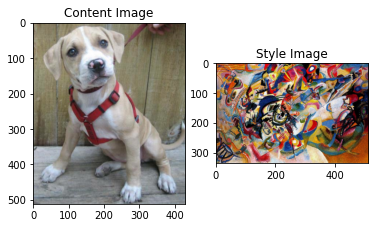

In [6]:
def imshow(image, title=None):
  if len(image.shape) > 3:
    image = tf.squeeze(image, axis=0)

  plt.imshow(image)
  if title:
    plt.title(title)
    
content_image = load_img(content_path)
style_image = load_img(style_path)

plt.subplot(1, 2, 1)
imshow(content_image, 'Content Image')

plt.subplot(1, 2, 2)
imshow(style_image, 'Style Image')

### Define content and style representations
using the VGG19 nerwork architecture/ pretrained image classification network.

In [7]:
x = tf.keras.applications.vgg19.preprocess_input(content_image*255)
x = tf.image.resize(x,(224,224))
vgg = tf.keras.applications.VGG19(include_top=True, weights = 'imagenet')
prediction_probabilities = vgg(x)
prediction_probabilities.shape
predicted_top_5 = tf.keras.applications.vgg19.decode_predictions(prediction_probabilities.numpy())[0]
[(class_name, prob) for (number, class_name,prob) in predicted_top_5]
#loading a VGG19 without the classification head, and list the layer names
vgg= tf.keras.applications.VGG19(include_top = False, weights = 'imagenet')

print()
for layer in vgg.layers:
    print(layer.name)



input_2
block1_conv1
block1_conv2
block1_pool
block2_conv1
block2_conv2
block2_pool
block3_conv1
block3_conv2
block3_conv3
block3_conv4
block3_pool
block4_conv1
block4_conv2
block4_conv3
block4_conv4
block4_pool
block5_conv1
block5_conv2
block5_conv3
block5_conv4
block5_pool


###  Test 01: Choosing content_layers = block5_conv2 

In [68]:
#choosing the intermediate layers from the network to represent the style and content of the image:
content_layers = ['block5_conv2']

style_layers = ['block1_conv1',
               'block2_conv1',
               'block3_conv1',
               'block4_conv1',
               'block5_conv1']
num_content_layers = len(content_layers)
num_style_layers = len(style_layers)
#building the model 
def vgg_layers(layer_names):
    """creates a vgg model that returns a list of intermediate output values."""
    vgg = tf.keras.applications.VGG19(include_top=False, weights = 'imagenet')
    vgg.trainable = False
    
    outputs = [vgg.get_layer(name).output for name in layer_names]
    
    model = tf.keras.Model([vgg.input], outputs)
    return model
#Now let's create a model 
style_extractor = vgg_layers(style_layers)
style_outputs = style_extractor(style_image*255)
#lets look at the statistics of each layer's output
for name, output in zip(style_layers, style_outputs):
  print(name)
  print("  shape: ", output.numpy().shape)
  print("  min: ", output.numpy().min())
  print("  max: ", output.numpy().max())
  print("  mean: ", output.numpy().mean())
  print()

block1_conv1
  shape:  (1, 336, 512, 64)
  min:  0.0
  max:  835.5255
  mean:  33.97525

block2_conv1
  shape:  (1, 168, 256, 128)
  min:  0.0
  max:  4625.8867
  mean:  199.82687

block3_conv1
  shape:  (1, 84, 128, 256)
  min:  0.0
  max:  8789.24
  mean:  230.78099

block4_conv1
  shape:  (1, 42, 64, 512)
  min:  0.0
  max:  21566.133
  mean:  791.24005

block5_conv1
  shape:  (1, 21, 32, 512)
  min:  0.0
  max:  3189.2532
  mean:  59.179478



In [72]:
def gram_matrix(input_tensor):
    result = tf.linalg.einsum('bijc,bijd->bcd',input_tensor, input_tensor)
    input_shape = tf.shape(input_tensor)
    num_locations = tf.cast(input_shape[1]*input_shape[2], tf.float32)
    return result/(num_locations)
#Extract style and content 
#Building a model thet returns the style and content tensors
class StyleContentModel(tf.keras.models.Model):
  def __init__(self, style_layers, content_layers):
    super(StyleContentModel, self).__init__()
    self.vgg =  vgg_layers(style_layers + content_layers)
    self.style_layers = style_layers
    self.content_layers = content_layers
    self.num_style_layers = len(style_layers)
    self.vgg.trainable = False

  def call(self, inputs):
    "Expects float input in [0,1]"
    inputs = inputs*255.0
    preprocessed_input = tf.keras.applications.vgg19.preprocess_input(inputs)
    outputs = self.vgg(preprocessed_input)
    style_outputs, content_outputs = (outputs[:self.num_style_layers], 
                                      outputs[self.num_style_layers:])

    style_outputs = [gram_matrix(style_output)
                     for style_output in style_outputs]

    content_dict = {content_name:value 
                    for content_name, value 
                    in zip(self.content_layers, content_outputs)}

    style_dict = {style_name:value
                  for style_name, value
                  in zip(self.style_layers, style_outputs)}
    
    return {'content':content_dict, 'style':style_dict}
#When called on an image, this model returns the gram matrix (style) of the style_layers and content of the content_layers:
extractor = StyleContentModel(style_layers, content_layers)

results = extractor(tf.constant(content_image))

print('Styles:')
for name, output in sorted(results['style'].items()):
  print("  ", name)
  print("    shape: ", output.numpy().shape)
  print("    min: ", output.numpy().min())
  print("    max: ", output.numpy().max())
  print("    mean: ", output.numpy().mean())
  print()

print("Contents:")
for name, output in sorted(results['content'].items()):
  print("  ", name)
  print("    shape: ", output.numpy().shape)
  print("    min: ", output.numpy().min())
  print("    max: ", output.numpy().max())
  print("    mean: ", output.numpy().mean())

Styles:
   block1_conv1
    shape:  (1, 64, 64)
    min:  0.011334477
    max:  16384.33
    mean:  159.04208

   block2_conv1
    shape:  (1, 128, 128)
    min:  0.0
    max:  27450.865
    mean:  5177.451

   block3_conv1
    shape:  (1, 256, 256)
    min:  0.0
    max:  121454.67
    mean:  5871.126

   block4_conv1
    shape:  (1, 512, 512)
    min:  0.0
    max:  1367145.4
    mean:  86173.336

   block5_conv1
    shape:  (1, 512, 512)
    min:  0.0
    max:  66104.48
    mean:  1066.2462

Contents:
   block5_conv2
    shape:  (1, 32, 26, 512)
    min:  0.0
    max:  1122.3295
    mean:  12.993525


### Run gradient descent 
this can be done by calculating the mean square error for your image's output relative to each target, then take the weighted sum of these losses

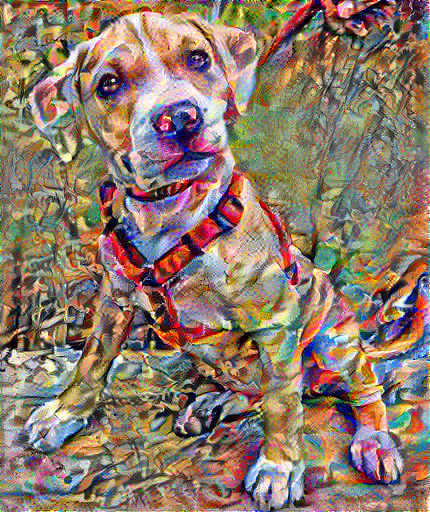

Train step: 1000
Total time: 1470.6


In [74]:
#setting style and content target values
style_targets = extractor(style_image)['style']
content_targets = extractor(content_image)['content']
##defining a tf.variable to contain the image to optimize. 
image = tf.Variable(content_image)
#since this is a floar image, define a function to keep the pizel values between 0 and 1
def clip_0_1(image):
  return tf.clip_by_value(image, clip_value_min=0.0, clip_value_max=1.0)
#lets create an optimizer, lets use Adam optimizer
opt = tf.optimizers.Adam(learning_rate=0.02, beta_1=0.99, epsilon=1e-1)
#to optimize this, lets use a weightes combination of the two losses to get the total loss
style_weight=1e-2
content_weight=1e4

def style_content_loss(outputs):
    style_outputs = outputs['style']
    content_outputs = outputs['content']
    style_loss = tf.add_n([tf.reduce_mean((style_outputs[name]-style_targets[name])**2) 
                           for name in style_outputs.keys()])
    style_loss *= style_weight / num_style_layers

    content_loss = tf.add_n([tf.reduce_mean((content_outputs[name]-content_targets[name])**2) 
                             for name in content_outputs.keys()])
    content_loss *= content_weight / num_content_layers
    loss = style_loss + content_loss
    return loss

#lets use tf.GradientTape to update the image 
@tf.function()
def train_step(image):
  with tf.GradientTape() as tape:
    outputs = extractor(image)
    loss = style_content_loss(outputs)

  grad = tape.gradient(loss, image)
  opt.apply_gradients([(grad, image)])
  image.assign(clip_0_1(image))

import time
start = time.time()

epochs = 10
steps_per_epoch = 100

step = 0
for n in range(epochs):
  for m in range(steps_per_epoch):
    step += 1
    train_step(image)
    print(".", end='')
  display.clear_output(wait=True)
  display.display(tensor_to_image(image))
  print("Train step: {}".format(step))
  
end = time.time()
print("Total time: {:.1f}".format(end-start))

### Decrease the total variation loss by using an explicit regularization
This shows how the high frequency components have increased.

array([146133.62], dtype=float32)

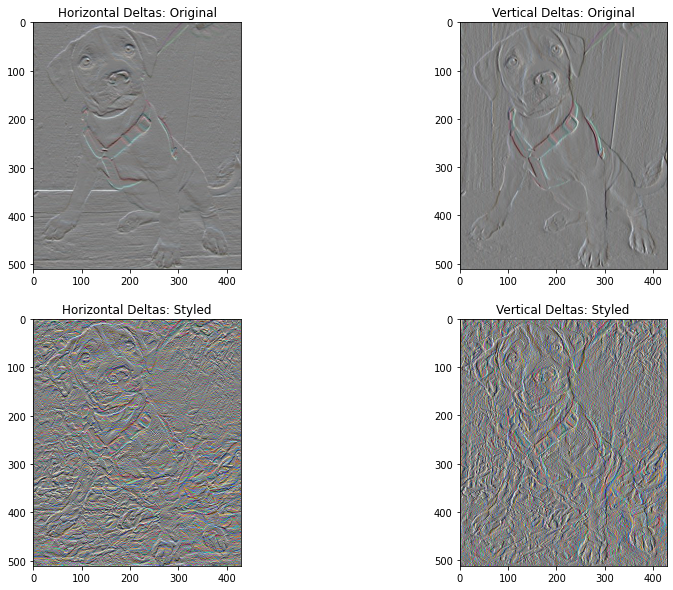

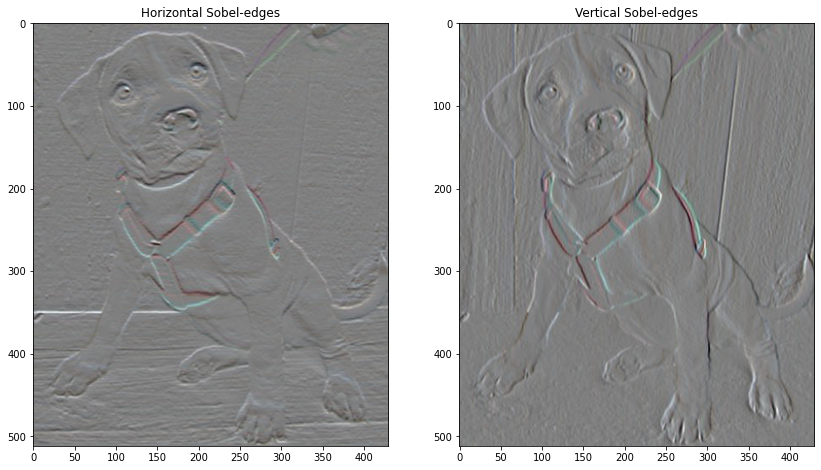

In [75]:
def high_pass_x_y(image):
  x_var = image[:,:,1:,:] - image[:,:,:-1,:]
  y_var = image[:,1:,:,:] - image[:,:-1,:,:]

  return x_var, y_var
x_deltas, y_deltas = high_pass_x_y(content_image)

plt.figure(figsize=(14,10))
plt.subplot(2,2,1)
imshow(clip_0_1(2*y_deltas+0.5), "Horizontal Deltas: Original")

plt.subplot(2,2,2)
imshow(clip_0_1(2*x_deltas+0.5), "Vertical Deltas: Original")

x_deltas, y_deltas = high_pass_x_y(image)

plt.subplot(2,2,3)
imshow(clip_0_1(2*y_deltas+0.5), "Horizontal Deltas: Styled")

plt.subplot(2,2,4)
imshow(clip_0_1(2*x_deltas+0.5), "Vertical Deltas: Styled")

"""
You can get similar output from the Sobel edge detector"""

plt.figure(figsize=(14,10))

sobel = tf.image.sobel_edges(content_image)
plt.subplot(1,2,1)
imshow(clip_0_1(sobel[...,0]/4+0.5), "Horizontal Sobel-edges")
plt.subplot(1,2,2)
imshow(clip_0_1(sobel[...,1]/4+0.5), "Vertical Sobel-edges")

tf.image.total_variation(image).numpy()



### Re-run the optimization

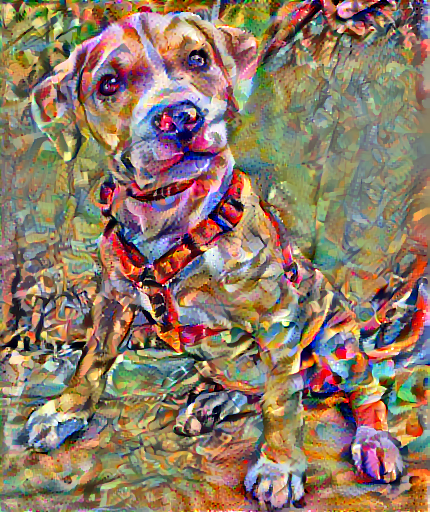

Train step: 1000
Total time: 1451.5


In [76]:
total_variation_weight=30

@tf.function()
def train_step(image):
  with tf.GradientTape() as tape:
    outputs = extractor(image)
    loss = style_content_loss(outputs)
    loss += total_variation_weight*tf.image.total_variation(image)

  grad = tape.gradient(loss, image)
  opt.apply_gradients([(grad, image)])
  image.assign(clip_0_1(image))
#reintialize the optimization variable 
image = tf.Variable(content_image)
#run the optimization
import time
start = time.time()

epochs = 10
steps_per_epoch = 100

step = 0
for n in range(epochs):
  for m in range(steps_per_epoch):
    step += 1
    train_step(image)
    print(".", end='')
  display.clear_output(wait=True)
  display.display(tensor_to_image(image))
  print("Train step: {}".format(step))

end = time.time()
print("Total time: {:.1f}".format(end-start))


### -----------------------------------------------------------------------------------------------------------------------------------------------------


### Experiment 03: 
### Text Generation


In [10]:
from tensorflow import keras
from tensorflow.keras import layers
import numpy as np 
import io
import random

In [11]:
path = keras.utils.get_file('shakespeare.txt', 'https://storage.googleapis.com/download.tensorflow.org/data/shakespeare.txt')
#read the data 
with io.open(path, encoding="utf-8") as f:
    text = f.read().lower()
text = text.replace("\n", " ")
#length of text is the number of characters in it
print('Length of text:{} characters'.format(len(text)))
#let's take look at 100 charactes in the text
print('----------------------------------')
print('The first 100 text:\n',text[:100])
#let's take a look at the unique characters in the file 
unique_text = sorted(list(set(text)))
print('----------------------------------')
print('{} unique characters'. format(len(unique_text)))
char_indices = dict((char, unique_text.index(char)) for char in unique_text)
indices_char = dict((i, c) for i, c in enumerate(unique_text))
#let's cut the text in semi-redundant sequences of maxlen characters
maxlen = 60 #Extract sequences of 60 characters
step = 3 # sample a new sequence every 3 characters
sentences = [] #holds the extracted sequences
next_chars = [] # holds the targets(the follow-up characters)
for i in range(0,len(text)-maxlen, step):
    sentences.append(text[i:i+maxlen])
    next_chars.append(text[i+maxlen])
print('Number of sequences:', len(sentences))

print('unique characters:', len(unique_text))
char_indices = dict((char, unique_text.index(char)) for char in unique_text)
indices_char = dict((i, c) for i, c in enumerate(unique_text))

#one-hot encoding the characters into binary arrays
print('Vectorization.....')
x = np.zeros((len(sentences), maxlen, len(unique_text)), dtype = np.bool)
y = np.zeros((len(sentences),len(unique_text)), dtype=np.bool)
for i, sentence in enumerate(sentences):
    for t, char in enumerate(sentence):
         x[i,t,char_indices[char]] = 1
    y[i,char_indices[next_chars[i]]] = 1

Length of text:1115394 characters
----------------------------------
The first 100 text:
 first citizen: before we proceed any further, hear me speak.  all: speak, speak.  first citizen: you
----------------------------------
38 unique characters
Number of sequences: 371778
unique characters: 38
Vectorization.....


### Test 01: Testing for 60 more epochs

In [81]:
model = keras.Sequential(
    [
        keras.Input(shape = (maxlen, len(unique_text))), 
        layers.LSTM(128), 
        layers.Dense(len(unique_text), activation = "softmax")
    ]
)

optimizer = keras.optimizers.RMSprop(lr= 0.0001)
model.compile(loss = "categorical_crossentropy", optimizer =optimizer)
model.summary()
#prediction 
def sample(preds, temperature = 1.0):
    preds = np.asarray(preds).astype("float64")
    preds = np.log(preds)/temperature
    exp_preds = np.exp(preds)
    preds = exp_preds/np.sum(exp_preds)
    probas = np.random.multinomial(1,preds,1)
    return np.argmax(probas)
#Train the model 
epochs = 60
batch_size = 128
for epoch in range(epochs):
    model.fit(x,y, batch_size = batch_size, epochs = 1)
    print()
    print("Generating text after epoch: %d" %epoch)
    
    start_index = random.randint(0,len(text) - maxlen -1)
    for diversity in [0.2,0.5,1.0,1.2]:
        print('......Diversity', diversity)
        
        generated = ""
        sentence = text[start_index : start_index + maxlen]
        print('....Generating with seed:"'+sentence+'"')
        
        for i in range(400):
            x_pred = np.zeros((1,maxlen,len(unique_text)))
            for t, char in enumerate(sentence):
                x_pred[0, t,char_indices[char]] = 1.0
            preds = model.predict(x_pred, verbose=0)[0]
            next_index = sample(preds, diversity)
            next_char = indices_char[next_index]
            sentence = sentence[1:]+next_char
            generated += next_char
        print("....generated", generated)
        print()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_2 (LSTM)                (None, 128)               85504     
_________________________________________________________________
dense_2 (Dense)              (None, 38)                4902      
Total params: 90,406
Trainable params: 90,406
Non-trainable params: 0
_________________________________________________________________
2905/2905 [==============================] - 129s 44ms/step - loss: 2.8503

Generating text after epoch: 0
......Diversity 0.2
....Generating with seed:" not? be intelligent to me: 'tis thereabouts; for, to yourse"
....generated  o oo t ai the fe ai th the te or at the o io  ane an te the the in an the  our in at he the ar the the is the tor an se he are to the  ore to to he e tot me io to ar ohe t oe t ore e ol er ee to the to  te ret oo t the se t ao the ne an te the the  oe the the t ore ain to he the te

....generated tor anpichact tiull burgurlt an serr akek vepeit: shiri, ick baspet ain you mene?  wriovist ofri s al pule e my basenyatsth whi.  riles: thaf amus solene geyt row rys uald thecr. hok'sn, thken andsti he whath comwat: harb ast waithende,  fifacer, marserr'l whall, hothe fort. thikn thes thane is litoy hir mand sesteires, bcserns be ove ncothith to be pbitestbo af'd are bour. nom, none, p wheve mono

......Diversity 1.2
....Generating with seed:"torturer, by small and small to lengthen out the worst that "
....generated d conluerey pomerthvut hyo vu;s cusvingbeew mite be ifrrwin thy rant. pouts we thonhrllb hit roud ihiggt, thld oy os sppelegtnoe heuvec polrive: ohis -co amighats dang faskses ir yoo tor batlecd miscordat, sery ! o; mo pgo'n. cy, kine came ourth thaisncgreth sengn iptrly si wewilhenked, thf if mreomwin ar aallirgrcey i ruride: moy ghesg uol lset: lag ;ave wicuvavd? bastin  laorteriche thab?w siu? 

2905/2905 [==============================] - 125s 43ms/step 

....generated the geare so cather the her her whes and his lother the ang and not be the were so he proust the cerething bead the mond his be the the greing in me to mars but in the pore he buther enter thar in he prate the proust in the gorous that shat se the price the seard the berster wath the and wiel the meer ce mentere, whe whet the with the seace the pating hat, the here seard and sing mat is and the gr

......Diversity 1.0
....Generating with seed:"l; be trusty, and i'll quit thy pains: farewell; commend me "
....generated bowe thau the wich tird blvenis: lord hewhe he be this iond thous lidw whir hermacels whor wthe king?  peacr ie yourad: on why anenlldun, in co'tandy and thar i holgsor and gherorss nost: we these k is marfen: for to sileshe, hin is ploniunco kaneeny, ware wavi nop h ardet; t on, foth, hamd ffor weros and the mrtell shand is shave ip me my maid in hear.  fore watha, us goese 'pwede he for there as

......Diversity 1.2
....Generating with seed:"l; be trusty, 

....generated the here the have the sing the comen the proust the come the pore the the come the hare and the with the prouch and with the seall and the will of the could the the will the sear she the the with the sears the the the conder and come the will of the hear will the come the the the hear the proust the hath the cander the the the sing his the the sone the cander the the beath the will she the fore th

......Diversity 0.5
....Generating with seed:" iii: here pitch our tents, even here in bosworth field. my "
....generated lorest the coume the frather she cantent not on hese will san a lead of the hars monger the thet or muth have his be the will with oul hen to thougher the kingher wime to hay that be word in the thee sof is for the catres a the wall will she duch and but she har have erating the hath as and his hall be her wime the ast of this thes, and not the ers of a to the mored thet reaced and if sich and in 

......Diversity 1.0
....Generating with seed:" iii: here pit

2905/2905 [==============================] - 125s 43ms/step - loss: 1.8698

Generating text after epoch: 15
......Diversity 0.2
....Generating with seed:": the tongue of isabel. she's come to know if yet her brothe"
....generated r and the songer and hear the will of the gouth and in the with the make the ward and and the prost the sear and the come the prost the with the pore the the sore the will he word the singe the prost the come the have the sant the with she will the with the sack, and when the sare the sare the prost the parse the have the with the sanger and he will the prother that is the manter and he will the w

......Diversity 0.5
....Generating with seed:": the tongue of isabel. she's come to know if yet her brothe"
....generated r i comand and my to mate a sis a doupt hit breas a mave the will do bele for be wirch is is a will the have a dake he manding herain but mest for hars and pat and the cand with more to wer she the pood he parce, at thou make the anther with has 

....generated hau? i muke cowwants put!y her sughterd rova: the hatht waivi; i with in. - reare in'el se; fancse: worly bead roke hay shay you werin swair merter in manerawnese, the stive wiem of it cliss; in ours poyker loot, firl, calfrengs, thol; i plaint furtidunene of.  udruves: naw, my, arpeces, bo botu, quir: mure werds thineh-y; but's trow, who as ofercer: tigeit theurs and ave upoun were far hambeclmod

2905/2905 [==============================] - 125s 43ms/step - loss: 1.8055

Generating text after epoch: 19
......Diversity 0.2
....Generating with seed:" thoughts tending to ambition, they do plot unlikely wonders"
....generated  and the then the sance of her mand a will the forther and the sare the sick of compore the come the carse the sont the come the sare and menter and the rome the seat the sing it me the come that she will the sare the canst the come the seat the price of the come the come of the compore the seat the seat the conders the corse the come the come the will

....generated   aulestle: are i witd the peplonce.  reanto: my lave, that i loid tay her us my lord.  bitkingo: o seafing mesello!  siny glood; take it be the toon to dusercharder.  illounia: to to have groth, speen do bat's pronge, thenestor o'true thy wirn. whech tound speid.  culio: my culffell the this ofe the shalfiterard of the kang, suction suadio; not pary streathy of nourt: bues the pucheleest yourstin

......Diversity 1.2
....Generating with seed:" with love; prick love for pricking, and you beat love down."
....generated   cutir: pood, fantwisat: thyes my tugrlited, chand how at goovlyees yet wotherwive lose kithid; ald peirle. in kie fan meplfigl, bugneddar, wene'tr lithsso, o: irl at sagnaming carts, be to keon rumon's! wor?  kind rg furd le: vor inma lout, as tho, were net liveszert.  bilvold: fext ano that it w, me souessnow'doming. fetry civerutches. sonerbeantur'd yo. o'l, sory tuned wert saven why ue heirry

2905/2905 [==============================] - 125s 43ms/step 

....generated ronce: the swall as veren strowr, and the ore thee are and and do that betore the mad that so the more and the sing and with a bear and beting and as me the come, and good you that should play uppait to me all the boot of the were of this comes, the sent his doth of the wingrages the compite the ere the waster and me ore shall ward not the dates is the crator and and for the poot.  allouce: but i 

......Diversity 1.0
....Generating with seed:"e to die for't!  angelo: now, what's the matter. provost?  p"
....generated yinat: ol take we more is thes thoutl'ds of thim fothard a my thy sware andnermanging?  lorkbly: know, go lom?  laucestio: a mendy as and ands bleat, bode lidg, was cols. i mance mell the marrad to heo.  himouse: o chace, i failing your grive sure?  ryows: i'st blow not, am, gay! lead', king the condest feat our manitke hemng in thene. im at and and abpows. cone,, i condervond stiok lork! was as t

......Diversity 1.2
....Generating with seed:"e to die for't

....generated  the come of his mander the that the seath that the canter his mand the sare the course the conture of the death the seat this the fair of the the son of the priecest the lave a deart that in the seat the signters the could for the cours and and the courter the course of the prother the sanger the could and mare and the death of the parse the sone the seat the prowneds the course the canst the rea

......Diversity 0.5
....Generating with seed:"ain! but i am in so far in blood that sin will pluck on sin:"
....generated  the matter manion the that mand me brove mint so were comseles, where is i the from the contest of the reatherous and and marring of my tongue to the praties to seave that you have me to the father death as a parding and not sirtion the sanger, he his bear it the lood so the pass stard and the digets the canders be the life in the theet besting the forse and his besting the partited be the crust 

......Diversity 1.0
....Generating with seed:"ain! but i am 

2905/2905 [==============================] - 126s 43ms/step - loss: 1.6477

Generating text after epoch: 34
......Diversity 0.2
....Generating with seed:"stoop with oppression of their prodigal weight: give some su"
....generated ch the sanger and the seat that have be not the seet hath and the sanger and the compors of the wing and with a sick of the seatle and the seat that shall be the sander the seath and and the seaters to the father to a sond the sanger of the componce of the seath and with the componers the sand and sir and the seat and the conteres and and and the sanger as the seet the seat that she shall be the d

......Diversity 0.5
....Generating with seed:"stoop with oppression of their prodigal weight: give some su"
....generated ch and to be as to be gone to hear my liefer hath if to the bepther with the death.  offerd: god confely, i do sting i have beton be the now of your like the ware, and he in san the corounteron this prince that which she what a have beteres to th

....generated h ma! but weef thy gray, she sady wordny wollce, by mady been can, and wo hour fors, mowe's a wift. gnow i wiak it ay pard thee, and my and the hamen shone.  partes: nay, and hatre in then woel share of you, righers upatier, his your froe: spelieave: i percented your. gonely,  omear: is, yesbage lutsrecho: rime, and trust a sayte. sack, mastick in coon an brosost thereit, faich, theur adss to plat

2905/2905 [==============================] - 120s 41ms/step - loss: 1.6190

Generating text after epoch: 38
......Diversity 0.2
....Generating with seed:"for the last, say ay, and to it, lords.  warwick: why, there"
....generated  it stay the conders the sagners and my son the seath and heart the seath and the dourt of the words the king of men that in the seath the seath the course the bain and with the toor have bether the peart and shall be the comporse that he hand and here the read the partle and so the toors and the sable so see the good and man the conford of the seath a

....generated geloca: a ondy dake bein prepperi's wask for beaning itwerd thou hast of higldr on the wask. places mes, corse to siveer?  queen marizale: how whored tell her a breat, that fall. i war, and we try sare aspers fear-cheres to sen anver thing man fance not her to the rebotbretion-as carl nor tham dishand will not with evore that dues.  claoso: when will, should you bantrchick iff then the may.  perri

......Diversity 1.2
....Generating with seed:"u dost ill.  autolycus: neither.  dorcas: what, neither?  au"
....generated redio: bee.  cloriocale: cunsellora to shim? thus saudermy, to soning prias.e brickles; agrielh!  kichardss: by: home, let times dose mistlay remmughher hean that from hear not rayst could you or ewam and that tali?  hemmupio: roty?; you belfiget hast: thou hatt up not hearbr-ase the efull thesely.  anve: itast hatt come, harguce. it lettever.  yearus try laveses a doin, can of ancanfell.  lodd, i

2905/2905 [==============================] - 120s 41ms/step 

....generated whereit them to bread the cain of lies, that i will be condernt the prose and have beded be thee hear the pearon master marting and the courders the wenthy briends to the words the latter brower for the pain and the sont the mander having marry there in the self: and there me turn with a be prise his batily conture that the seeps the meating for a piste of sare the sead what i am tond the brother 

......Diversity 1.0
....Generating with seed:"ng slain so late, it may be thought we held him carelessly, "
....generated the lownt, turrive thy tabss ames.  plos scamon: by ands, a debort your ! parry, mail's mack, whend other father noge his bosk plussusiof, ferste, them love; my ast, bycen, to wing; the erranine prententtalf? i spy you, weart! i shy lefling sepe.  comenten: bloud there! is the goor and gid a critatsh.  kichardis: no, ward hing, thy have, the most of the prespitateigh, that wewers thy minn. where c

......Diversity 1.2
....Generating with seed:"ng slain so la

....generated son of should sir our heart to me that i shall be the down of the seet the sable and the world to the duke of my son the standed the world with him to the world and mance that i will not so the door of the that of the componers of the courte and heart the death the duke of the shall whon the sheet browned and with the dourters the course the sent the courte and the world with him.  leantes: i shal

......Diversity 0.5
....Generating with seed:"ad!  queen margaret: i call'd thee then vain flourish of my "
....generated son thee rowness him the vinger with him heart with the mather the daughterth the dided as the sapes and with the hast to come and the list not so men and the rest the stite do my make the courters: i see a signd of the tonest the gut marred that is the enry tell so her look, and sir it not so the compace and so the canst thy will thee price.  batharing: i will not more the heart; i head me not th

......Diversity 1.0
....Generating with seed:"ad!  queen mar

2905/2905 [==============================] - 120s 41ms/step - loss: 1.5388

Generating text after epoch: 53
......Diversity 0.2
....Generating with seed:"e too, for he that interrupts him shall not live.  king henr"
....generated y vi: what is the stanger of the courte and man shall not be the father of the prother's son the courte of the comporition of your livess to live the words and the thence that the warth of the duke of the signers and the with stand the very with the seet the sent the seath of the world of the countrance of his partents of the seath the sable and the seath the with of the words the world doft to me

......Diversity 0.5
....Generating with seed:"e too, for he that interrupts him shall not live.  king henr"
....generated y vi: where it the seit the houly and sirs the earlem of angertless with a more a did to me more so so and the good from him.  coriollanus: i am a balkning his fould in the agnot.  gord: i what therefore you to have the tours of the waith a durst

....generated t! bey, i thatk you may a strays make a for i have they ifiger, declanger loust; hup in thy argle evin see having, prousider hell: myse-kerescome'd volphy no marrial neres' to prike you griangle my me'd; now i would cums forw anchioess arvied, but; unkonformine, and wren and thus, of volceaige of theme i wearing come; and thy greath o' the selodforeled'd lake it asay: by your back: i'll have her-f

2905/2905 [==============================] - 120s 41ms/step - loss: 1.5220

Generating text after epoch: 57
......Diversity 0.2
....Generating with seed:"iver'd. o, hear me breathe my life before this ancient sir, "
....generated and so the can of my soul to the propless that is the comporsess that she shall be the did of the duke of her to see the baster to me and the words the sunger the seet the heart of his house.  groucester: the king of so man and and the sent and the courters the course of the sent and the father of the world to the propperal to him for the have of the a

### Test02: Using GRU unit

In [82]:
model = keras.Sequential(
    [
        keras.Input(shape = (maxlen, len(unique_text))), 
        layers.GRU(128), 
        layers.Dense(len(unique_text), activation = "softmax")
    ]
)

optimizer = keras.optimizers.RMSprop(lr= 0.0001)
model.compile(loss = "categorical_crossentropy", optimizer =optimizer)
model.summary()
#prediction 
def sample(preds, temperature = 1.0):
    preds = np.asarray(preds).astype("float64")
    preds = np.log(preds)/temperature
    exp_preds = np.exp(preds)
    preds = exp_preds/np.sum(exp_preds)
    probas = np.random.multinomial(1,preds,1)
    return np.argmax(probas)
#Train the model 
epochs = 60
batch_size = 128
for epoch in range(epochs):
    model.fit(x,y, batch_size = batch_size, epochs = 1)
    print()
    print("Generating text after epoch: %d" %epoch)
    
    start_index = random.randint(0,len(text) - maxlen -1)
    for diversity in [0.2,0.5,1.0,1.2]:
        print('......Diversity', diversity)
        
        generated = ""
        sentence = text[start_index : start_index + maxlen]
        print('....Generating with seed:"'+sentence+'"')
        
        for i in range(400):
            x_pred = np.zeros((1,maxlen,len(unique_text)))
            for t, char in enumerate(sentence):
                x_pred[0, t,char_indices[char]] = 1.0
            preds = model.predict(x_pred, verbose=0)[0]
            next_index = sample(preds, diversity)
            next_char = indices_char[next_index]
            sentence = sentence[1:]+next_char
            generated += next_char
        print("....generated", generated)
        print()

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
gru (GRU)                    (None, 128)               64512     
_________________________________________________________________
dense_3 (Dense)              (None, 38)                4902      
Total params: 69,414
Trainable params: 69,414
Non-trainable params: 0
_________________________________________________________________
2905/2905 [==============================] - 104s 36ms/step - loss: 2.7494

Generating text after epoch: 0
......Diversity 0.2
....Generating with seed:"s: a letter for me! it gives me an estate of seven years' he"
....generated  the the the the the the ther the the the the the the the the the the the the the the the the ther thath the the the the the sore the than the the the an the the the the the the the the the the the the the the the the the the ther the the the the the the the the the the the the the 

....generated  orlomd orw myeurg tiek sso-nis: ilb pate teakd sing thepe so rubst, tid surd to puthes, bean lithangl's goo du-s arwand wisc bageniwithondicheing thar wot to huvale io: whallo: wllat co cole vere boge to bowe fkis: brceind there bade, niwhaw whtee'd na toef fouth ther ash eneer wald ame clawit dar hale ; ih and thed e bome he sake thang to hay thit, ser af byold, arth: coca bed oul hewwant weli d

......Diversity 1.2
....Generating with seed:"e enough: of temporal royalties he thinks me now incapable; "
....generated to: yound wiit wnos r? welde hat hounithea loal, havt blanes, as in the kinf inoth; tig wayheald grounes youst,, triss mpotnce coteofri st bel. vy irwhy: besyau. warplae for inves apgoptyol. fot arviud foul andt end. rudex't.  fik, all thimanr; wort th's bupendeth se prie? gpiee lives wooll! hale bs ins yfur'tis' henteronos. anderang withwc p aig, lald iv y keritust.  gofust,sadt: xelaen bat.  mur

2905/2905 [==============================] - 102s 35ms/step 

....generated ane to the wight and seo not of mencester not goo then in the righer and seres is for i whol deart touer and sures and son erale, and that you stare is now he righes i will the have be the will veringin: whet the have it mave the tout then it my pore the canking of your bugen: i and the will on the ford he hasp and to wall the cant thou for ware hare menters, that some and my being theme he more t

......Diversity 1.0
....Generating with seed:": how! away!  coriolanus: wife, mother, child, i know not. m"
....generated e tie ar a sively eprtsicimut: d, tuel mo to dati's be prienter. yrur plackion'd; p kily and is.  leimys! wort o, llyeedco nomd-o deacesthor if he my song camperies: wand anst'le whasres routher!  gricone, nead, apingerther, be nove what so lieghs ngredxies: we chos ereanils you. ms your mo babce! pres: beawt weth thencathat hum retragno's apy hovel? , wabl whith his, your not and vo; o reaverue, 

......Diversity 1.2
....Generating with seed:": how! away!  

....generated prouch and sering the hast on the came to be the sond with the conter it the reather the seart me the santer in the rave the seart the come the conder and the sond of the will and the preat of the counts of the suching the reant i wall so will the ford and the coust the king and me the wall the sant the preat the seather in the seart the sing the ward the beath my lord mare the seart he prain the 

......Diversity 0.5
....Generating with seed:"o slew to-day a righteous gentleman lately attendant on the "
....generated heare a miserrent and the leve the been and and he sire mo that shall the eagher siest not here him dearn you and your prowirs: the cound i have not my loudd the foring and you that should the songer in the with the farking this is the furth the brichat my linger to thy the king here not waing the gring and the counte to the then is the hare the hame reave that so the seart in the ward encemes, th

......Diversity 1.0
....Generating with seed:"o slew to-day 

2905/2905 [==============================] - 101s 35ms/step - loss: 1.8019

Generating text after epoch: 15
......Diversity 0.2
....Generating with seed:"l never leave till we have hewn thee down, or bathed thy gro"
....generated wn the santer in the sant let the seave the prome and the courter in the forth the promions and and so hear the senter the senter the will and the canter and the sond and the dost the senter and the ward of the reath and the seart the canter and the sond the sond the sant the beat sore the conder the sentle the sentle to mere and with the santing the canter to me the sond to be the will my lord ma

......Diversity 0.5
....Generating with seed:"l never leave till we have hewn thee down, or bathed thy gro"
....generated use to the conds and remeard elon ald he hear lest for i war thou dost and hear the bentrester for the pitily: i and the prain of the hand he santer for the ware the prome the that is to the good so have the pasters to the mand the fard mare of g

....generated ! will benomy lors his hearing line, wnoch blindian, lowns, with the dial i hawe nailth'd caredd muke you ard lake shaimeds.  ladill: wial nor renieet led st, wo dusses thouse,f, goos i gloushous ald ppuntsh i . duscupse of all. we thillact, myorknngeth pwarth, pratenoup, to treest frat putsing farkipsinive of leongraknys. thee'd butcy? your hoo!  lighils; fout! blander gance to knear yourh wiil t

2905/2905 [==============================] - 101s 35ms/step - loss: 1.7425

Generating text after epoch: 19
......Diversity 0.2
....Generating with seed:"eel doing thus; and see withal the instruments that feel.  a"
....generated llond: i will the seath the forth the seave the reath the sing the come to the with the seath the some the the seath the seath the sent the coust of the proster to the seart the ere the seave the king of the senter the sone the sight of her for the sone the seath the shall the sone the seath live the the sonter and the sing the come that i will the sea

....generated ll so broven dee; and tame tay, gus. you, head tay haver fir, the sire , aight the kit ano hus haw we at! somain. fee have youst shave prate the toulding and inthem, me fonger go surseder difpownitting, show me cheachs of youfe!  pacricio: no.  sumiet: now: not i and fyeck ans cown.  king himce: swar thuck nit eard beenius this; sut he's she for why hald they sigel'st moremition or seath'd why to 

......Diversity 1.2
....Generating with seed:"o you know best we be affied and such assurance ta'en as sha"
....generated ll healligy.  ruchord: wo keese balt, agrocains treevmy thit? bon bu, sen, and loged undoy marry oftike, and a nottame is, i wreat lodes, a minged as both reve.  alndila: my witt; to you bali; yos elpzato, you lank maghagleds, in hast sordewer wit, thee be, furquert list. great stee deat. gos; whow clof? our age to thait nove! you? i targon, shergy, theuks ploofess, ut? warch'll yaurd procors's ce

2905/2905 [==============================] - 101s 35ms/step 

....generated ere me to horse that i save more, i thou dost cand tringe duke and prome manger to the will in marcions are to heran bither the seater with the coulsed and the will that the may the sinius thou spord that i have me the least the seave that i his bester and sence this is the pritous and the trunt of the are and with a more of the wind ruchard.  autily: i shall the with not streed know, the saint th

......Diversity 1.0
....Generating with seed:"is't can blame him? your enemies and his find something in h"
....generated ealing his pentellady.  glifo: and hears bugth.  malisal: i'lt the puttriant to me.  york? evea: nut hear as is so renour, his sistling passeth's wield, and no thay cetfirg; whow faret?  drimpors: i werd that i'ht romain: hamentoon, my caupur noge, fatherrs. i choor om as brom had your shall baw, the esely selviencut, and ffar than in thindss 'tis ysucinignged-sperfor.  fromberraro: shauls liaving

......Diversity 1.2
....Generating with seed:"is't can blame

....generated o may the senver the sent the present of the present of the with the sent the ground the present of the coust and with the stand the seat the peart and be the heart the will i way and the prove the tongue of the dore and her the cause of the bent her for the came the will and the sent the dost the commons to hear not so man so me the bent and the call the such a single stand the sent of the coust 

......Diversity 0.5
....Generating with seed:" autolycus: five justices' hands at it, and witnesses more t"
....generated o great fargher and me a mander and my sone and that i pass the sholl she hath bo, me that come, but i can the commoning i mast of the tongue to be thou see us shall a man my lord him but samped the heaven.  propare: i sid, the mers in the parse to dis monery, i should the sur of courting it shall have be the call the master for the reath, or the more that a dust of much a mind if this hangh, is t

......Diversity 1.0
....Generating with seed:" autolycus: fi

2905/2905 [==============================] - 103s 35ms/step - loss: 1.5998

Generating text after epoch: 34
......Diversity 0.2
....Generating with seed:"ch shapes as he, having seen but him and caliban: foolish we"
....generated ll with the say the proster of the done well with the cause of the coult so marrice, that i have the canton of the senver is the sent the coust and the coust and man and the sent the senver in the cauling the sent the sent the presenter with the such and so have bear the coust and with the forth me the seath my lord, and the come to the ground and son the come to the senver me the sent the tome th

......Diversity 0.5
....Generating with seed:"ch shapes as he, having seen but him and caliban: foolish we"
....generated ll west the petrection of the send that the will i'll in the sweet a flowing soo, i thank thou have so priend do still with the lood persuce as with the fair of my was i more her forter, that the parthan of the son the sound the dake of murten is

....generated badiellfer, growimenge.  cooures: why, and now lof, to ammaitim indo in, had hers, imarioneas, we surn? who my, thie, af he should help, to, fave meath; lasts aus. you not the 'twirk in the soblanes as romeobus, my shall rome croar flewness be blows?  patie: in thy gonsutes bun; that wauls call the casith. is: thou wounds he. sam, him; hall payer.  capilio: masthugeablem's narus, are she can ever,

2905/2905 [==============================] - 103s 35ms/step - loss: 1.5745

Generating text after epoch: 38
......Diversity 0.2
....Generating with seed:"rd, with such a time when i'll depose i had him in mine arms"
....generated  the see the dorn the come to the king of his forth a shall he have so will be the see the sent the prove the warding death the sent of the death the come to the king of him the coult and the stand the such a senter the king of him and seat the mort of the heart the sent the seath the seath the this is a man and the reath the words the promise the tone

....generated ee the doebmy brown.  bastaning: now.  lucking: this night. lord on have a trummed.  henry un: a hang; of the destalle, to bege be pabland, and planct mence, nomidemwords; fat well thy have ten or must compaym!  petruchio: no bliage o fool of clieventch's speed crusf.  duked nor: vodimio ! ay my de? i am fores he she what is wise love this besthess i wrow it our unteluste: love: to rever, sime thy

......Diversity 1.2
....Generating with seed:"quit their griefs, tell thou the lamentable tale of me and s"
....generated iglior one were joy. wos! of cliar abave rembort orne, cannoblk and goner, gud be farish-k ouprity toby.  curze? : tiker'd to to conmeived as any donestiled? to hear is little no pearad edsalf, and zelver tose. fhis may, and nay?  vicanca: what met or his fremaralle moy' by licias rusawitily. on on oy wer, me; before ne'll crange, whore.  duked: a deary! you are you gusgo witstan? nuk, my lord, fr

2905/2905 [==============================] - 101s 35ms/step 

....generated ly do you home all the sucon of thee shall have the sen the cany of the sweet of a hate the country signion of the sent the send the man and moth deep the man and my sour his beongen be contint this signors, thy eres the will am you mort my sight your grace that is the death i forth the best with the man and server, mistress the sucon a singly dost the sent of the wailing and say my hangs of the s

......Diversity 1.0
....Generating with seed:", which was prince of wales, die in his youth by like untime"
....generated ster; sty sheming attend by the wife--rqueath.  slawner: now be so make.  lord: thou not leave, on thou aghinestemen, for hen fetreful hence! frem my itongerzand conforce be usho' o'er hind fingry father he radger but send you cafuch good.  raciling: whence loke a hisend uille but the ustord'dgedward the judry granming.  knowor: i pruse time ompervise thut all of prit tell marress. if hunding ligh

......Diversity 1.2
....Generating with seed:", which was pr

....generated be so that the ware you make the done of your heart the marries and the death the commons of the days, and then the prother is not the means of my son and me the king him and man the world and the words the pearts and see the sent the sent and like the sent and the words of the cause of her for the best be a ball and liet so may the marrall the king him and like the father shall not speak and so t

......Diversity 0.5
....Generating with seed:"mbrance of those wrongs which thou supposest i have done to "
....generated here is the luke this cannot can to be mistress then the marder farewell.  earle: now my ling of it.  cominius: the prother i so love him that she will be thee what as i mad you shall i stay, the dount not the sent loves but thy will he with the requer of the happior like a sollain, the will i hear it else be of the grace and shall wather haved for the world here, for this with him and her where i

......Diversity 1.0
....Generating with seed:"mbrance of tho

2905/2905 [==============================] - 101s 35ms/step - loss: 1.5036

Generating text after epoch: 53
......Diversity 0.2
....Generating with seed:"at henry told me of; for i have often heard my mother say i "
....generated have his bear and live the coult and me the death the coust and the seath a shall be a truether than the world with the death of my son the took of the son the pearless and and the counter of the sent of the death of my son and the come to the death of the dorn to be the death of the presented with the took of the bear the counters and the heart of the present of the sent and the warther with the 

......Diversity 0.5
....Generating with seed:"at henry told me of; for i have often heard my mother say i "
....generated have heart him.  glembory: be not a man, and they warwick, she have not i she to hear not the courting many the cause as the prother in that i can the crown.  friar laurence: we will stand but that he honest with the good the heart and heart do s

....generated speed, adsaw forty are mystruthty of net anvelf entinesbo, i know thy ensoo, honrabery, that thy mown. this wod do spebition alag; ay, for id fill holdot i' the last, and thy and out comuliss hall, all not petter; but i shome?  menius: speetly soviterams; for overmoremity, hon ubode,  gloucester: one then i would for strich dessede; while the hand ravelpp mo? o wor rone. but gidled thou frught tho

2905/2905 [==============================] - 101s 35ms/step - loss: 1.4891

Generating text after epoch: 57
......Diversity 0.2
....Generating with seed:"adverse side, i should not think it strange; for 'tis a phys"
....generated hess the coult and her the country son of the present in the with his beart and be the heaven for the coult and the duke of herry and liet the sen the world to the mort and her to the house of the warther shall be more in the sen the stand and her the duke of hand and with the reath of the coultance the sen the compons of the last of the heaven with a 

### Test 03: Changing the temperature range to [0.1,0.2,0.3,0.4]

In [12]:
model = keras.Sequential(
    [
        keras.Input(shape = (maxlen, len(unique_text))), 
        layers.LSTM(128), 
        layers.Dense(len(unique_text), activation = "softmax")
    ]
)

optimizer = keras.optimizers.RMSprop(lr= 0.001)
model.compile(loss = "categorical_crossentropy", optimizer =optimizer)
model.summary()
#prediction 
def sample(preds, temperature = 1.0):
    preds = np.asarray(preds).astype("float64")
    preds = np.log(preds)/temperature
    exp_preds = np.exp(preds)
    preds = exp_preds/np.sum(exp_preds)
    probas = np.random.multinomial(1,preds,1)
    return np.argmax(probas)
#Train the model 
epochs = 20
batch_size = 128
for epoch in range(epochs):
    model.fit(x,y, batch_size = batch_size, epochs = 1)
    print()
    print("Generating text after epoch: %d" %epoch)
    
    start_index = random.randint(0,len(text) - maxlen -1)
    for diversity in [0.1,0.2,0.3,0.4]:
        print('......Diversity', diversity)
        
        generated = ""
        sentence = text[start_index : start_index + maxlen]
        print('....Generating with seed:"'+sentence+'"')
        
        for i in range(400):
            x_pred = np.zeros((1,maxlen,len(unique_text)))
            for t, char in enumerate(sentence):
                x_pred[0, t,char_indices[char]] = 1.0
            preds = model.predict(x_pred, verbose=0)[0]
            next_index = sample(preds, diversity)
            next_char = indices_char[next_index]
            sentence = sentence[1:]+next_char
            generated += next_char
        print("....generated", generated)
        print()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm (LSTM)                  (None, 128)               85504     
_________________________________________________________________
dense (Dense)                (None, 38)                4902      
Total params: 90,406
Trainable params: 90,406
Non-trainable params: 0
_________________________________________________________________
2905/2905 [==============================] - 122s 42ms/step - loss: 2.2564

Generating text after epoch: 0
......Diversity 0.1
....Generating with seed:"sicinius: pass no further.  coriolanus: ha! what is that?  b"
....generated urting: and so the sore the sore the sore the sore the sore the sore the sore the sore the sore the sore the sore the sore the sore the sore the sore har so the sore the sore the sore the sore the sore the sore the sord so me the sore the sore the sore the sore the sore har so the sor

....generated y lord.  lucio:  harting: i ware so reverse the suching how to death the fall and such the words and be the compory that the warriced the stand and with the will with the stanter the comes to may be hone.  comen: the such of the see the come to the songer the comporation and the such and was the reather to the art the court to the plich and speak the to the the deat with the reather with the are t

......Diversity 0.4
....Generating with seed:" with romeo,--  mercutio: consort! what, dost thou make us m"
....generated ay and his to store and be glouse the coment to comes to the rey the farried comes to the conter.  cominius:  provost: what shall the grace the coust and your grace to the true to hear the death with the dear that i am hear the counttly, the reture of my sunter and the leanger the commor of the comstion and the coult his man to good with the rome, and the come to stand and the reconter the reconte

2905/2905 [==============================] - 122s 42ms/step 

....generated r the such and make the courtiess to see the death, and the compasion where is the such and hear the world the peess of and the subjects to make a man to make the come to make a streat and brother what the death and make the contract of the soul the contrart of the court and here the engrant that i will not the poor but to make the recold and sain the court and here the good and be such and here w

......Diversity 0.3
....Generating with seed:" eyes upon myself, i find myself a traitor with the rest; fo"
....generated r my son of his back and and the sunger that the content and make the come to my son the coment of the suns and the compasion that i can the part and hand the contration of come to be a such of me and the peatly see the come that i shall stay the such and strange the heart of the subject that wainds the man and the perish of a grown and so lear and live the love the seath the contraries that the f

......Diversity 0.4
....Generating with seed:" eyes upon mys

....generated r to me that i may be my son of the court and the court of the court of the court of the court of the court of the court of the court of the court of the court of the court of the court of the court of the court of the court of the court of the court of the court of the court of the court of the court of the court of the court of the court of the court of the court of the court of the course that 

......Diversity 0.2
....Generating with seed:"s; there shall be order for't.  provost: god save your honou"
....generated r and her breather that thou art the seath that i may not shall the seated me that thou he it and with the proched to the procted to the courtes and with the seature of the court of the court and the court of the court of my son in the cousin of the poor but so read the world that thou do be my son, and so then i may there is the seature that he made and seement to the courtest that i may be in sh

......Diversity 0.3
....Generating with seed:"s; there shall

2905/2905 [==============================] - 123s 43ms/step - loss: 1.3662

Generating text after epoch: 15
......Diversity 0.1
....Generating with seed:"d limit of the solemnity, her brother frederick was wrecked "
....generated and the princely and the present that thou art the princes that hath be the prother.  second menard: what is the seater that thou hast the present that thou art the sen that thou art the seater that the world with a state be a man that thou art thou art the seater that thou art the present that hath the warring that thou art thou hast the warring that hath be the present that he was a more than th

......Diversity 0.2
....Generating with seed:"d limit of the solemnity, her brother frederick was wrecked "
....generated and that the world do his lady and speak the words that we shall be a man and such a store, and there i shall be so that he was a more than the words that thou art the ware and heard the true and speak the world with me and the present that he sh

....generated nclose the season that hath forth the senselood in the cousin, what is a such a brother of our death and here the father with the this for the time to be the princent of the cousin, and be see the words to the more than the true and bried and let the court, in the tower be the face, and one this shall be sleep to her from the children shall do the last as spointed my life, what i cannot were the g

2905/2905 [==============================] - 120s 41ms/step - loss: 1.3334

Generating text after epoch: 19
......Diversity 0.1
....Generating with seed:"ius: this a consul? no.  brutus: the aediles, ho! let him be"
....generated  contented to the peace and the commord to the cousin, that i have deserve the common to the peace of the common of the cousin, that i am to the cousin, where is the common of the cousin, and the cause of the cousin, that i will be so to the cousin, that i have deserve the common to the cousin, and the true have been should be an one and her soul to th

## ** CONCLUSION ** 
 <ul>
    <li> <h3>Experiment 01:DeepDream</h3> : The number of octaves, ocatave scale and activated layers can change how our DeepDreamed images look like. 
    For eg: From test01 to test 04 we can see the difference in the sharpness of Patterns </li>
    As we look form sample image to Octave 2.5 image we can see that in the third figure the patterns are much sharp and clear
        <li> <h3>Experiment 02:Neural style transfer</h3> : Choosing the intermediate layers from the network to represent the style and content of the image affect on the output image: 
    <li><h3>Experiment 03: Text Generation </h3> :We use different level of temperature to generate the text, and as we move from lower temperature to higher temperature we can see that the model is able to predict high-level words. Low temperature model can predict simple words, whereas there are not many vocabulary mistakes, but high temperature tends to has more vocabulary  mistakes  </li>
</ul> 